- https://paperswithcode.com/sota/image-generation-on-celeba-64x64
- https://www.youtube.com/watch?v=HxD-M-jTmEA ("Anime Face Generation using DCGAN | Keras Tensorflow | Deep Learning | Python")

- how to read papers: https://www.youtube.com/watch?v=JuG6ZcNe_3Q&t=206s


TODO:
- https://www.youtube.com/watch?v=b3KGSsNSzZg (How to implement StyleGAN from scratch - using the original Paper!)
- Intro to how GANs work: https://machinelearningmastery.com/introduction-to-style-generative-adversarial-network-stylegan/

In [ ]:
# Import Modules
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm
from PIL import Image

import tensorflow as tf
from tensorflow import keras
#from keras.preprocessing.image import load_img, array_to_img
from keras.models import Sequential, Model
from keras import layers
from keras.optimizers import Adam
from keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [ ]:
# UNZIP THE FILE (upload PokemonImages32.zip)
!unzip -q "/content/PokemonImages64.zip" -d "/content/tmp"

In [ ]:
# Load the files
BASE_DIR = '/content/tmp'

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
len(image_paths)

4288

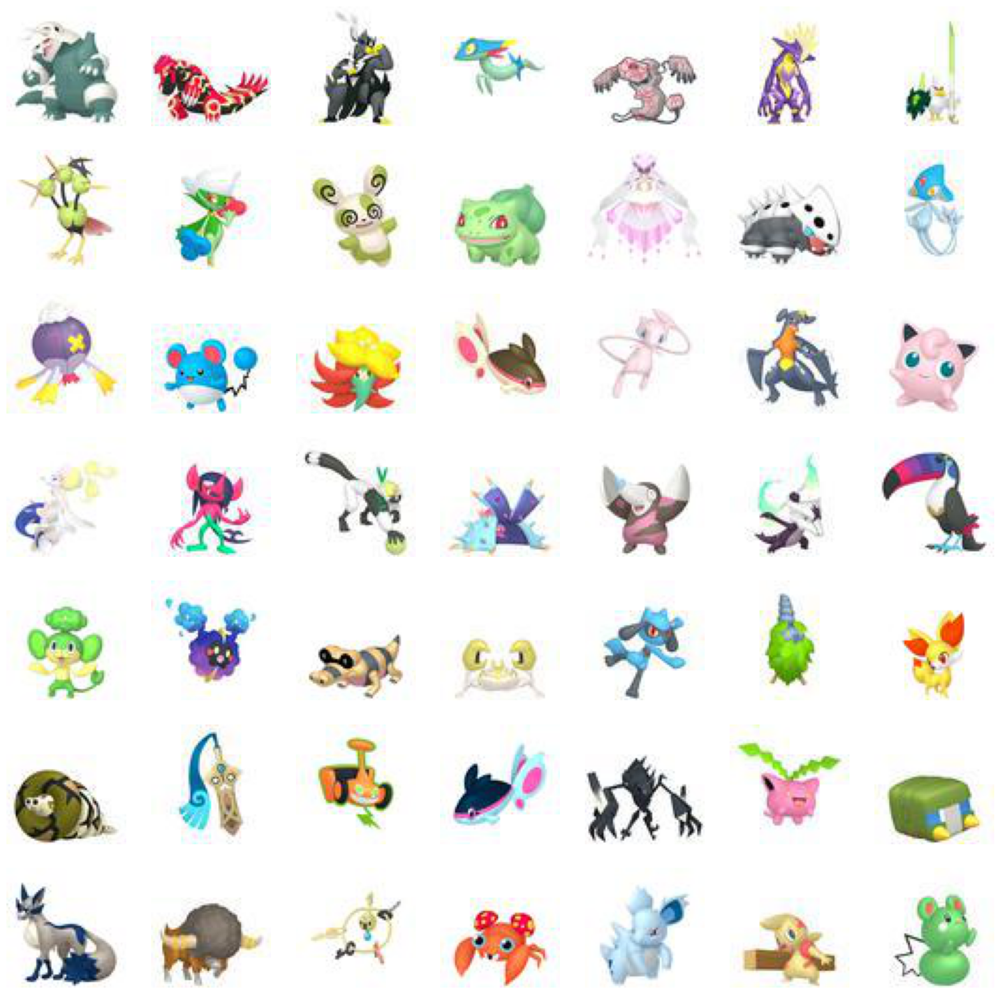

In [ ]:
# Visualize the Image Dataset
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = Image.open(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [ ]:
# Preprocess Images

# Load and convert images to numpy array
train_images = [np.array(Image.open(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

train_images[0].shape

  0%|          | 0/4288 [00:00<?, ?it/s]

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       [[1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        ...,
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ],
        [1.        , 1.        , 1.        ]],

       ...,

       [[0.9764706 , 1.        , 0.9843137 ],
        [0.9764706 , 1.        , 0.9843137 ],
        [0.9764706 , 1

In [ ]:
# Create Generator & Discriminator Models
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [ ]:
# Generator Model

model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 256)      2097408   
 nspose)                                                         
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

In [ ]:
# Discriminator Model

model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 64)       256       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

In [ ]:
# Create DCGAN

class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = tf.keras.utils.array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
# CONTINUING TRAINING (IF LOADING PREVIOUS MODEL ONLY)
generator = tf.keras.models.load_model('/content/generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
  6/134 [>.............................] - ETA: 9s - d_loss: 0.2924 - g_loss: 1.9740 

134/134 [==============================] - ETA: 0s - d_loss: 0.3133 - g_loss: 2.2661

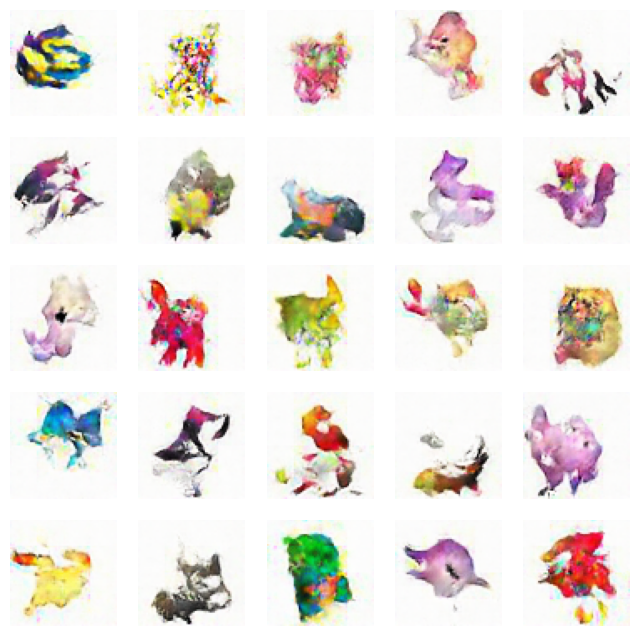

134/134 [==============================] - 9s 68ms/step - d_loss: 0.3133 - g_loss: 2.2661
Epoch 2/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3250 - g_loss: 2.1964

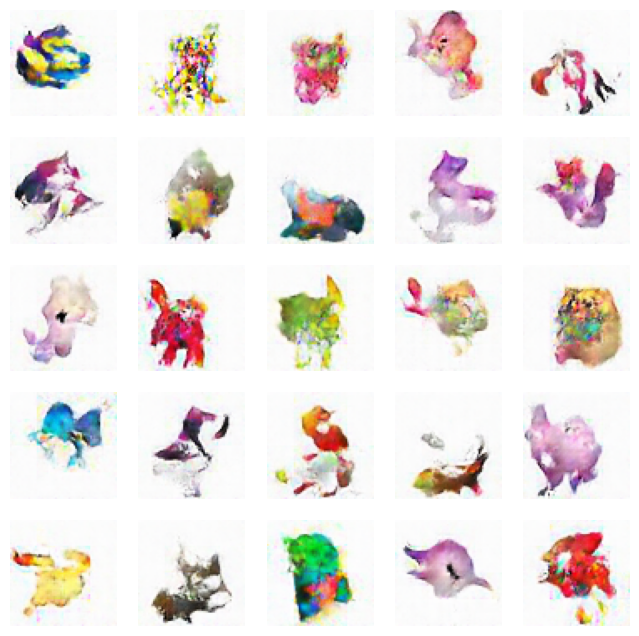

134/134 [==============================] - 9s 71ms/step - d_loss: 0.3250 - g_loss: 2.1964
Epoch 3/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3155 - g_loss: 2.2480

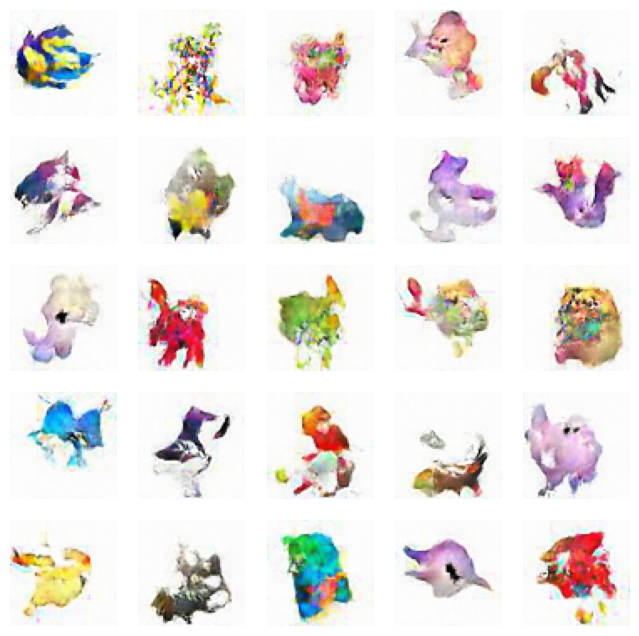

134/134 [==============================] - 9s 71ms/step - d_loss: 0.3155 - g_loss: 2.2480
Epoch 4/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3358 - g_loss: 2.2858

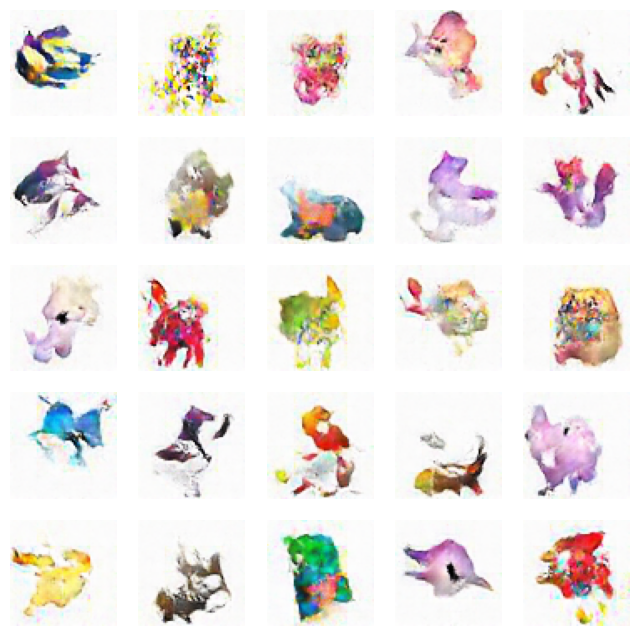

134/134 [==============================] - 10s 71ms/step - d_loss: 0.3358 - g_loss: 2.2858
Epoch 5/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2982 - g_loss: 2.3174

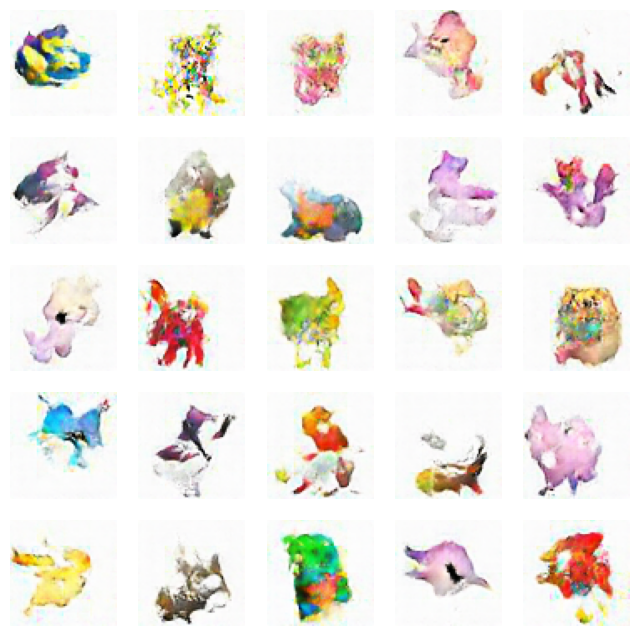

134/134 [==============================] - 9s 69ms/step - d_loss: 0.2982 - g_loss: 2.3174
Epoch 6/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3482 - g_loss: 2.2481

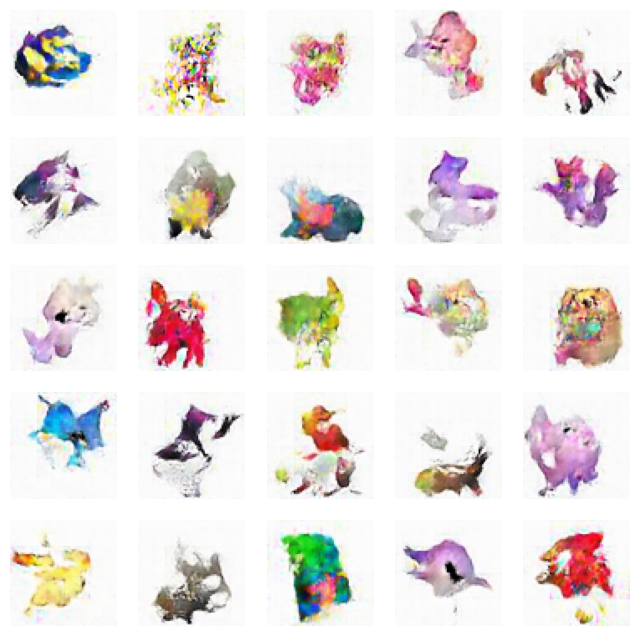

134/134 [==============================] - 10s 73ms/step - d_loss: 0.3482 - g_loss: 2.2481
Epoch 7/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3390 - g_loss: 2.2540

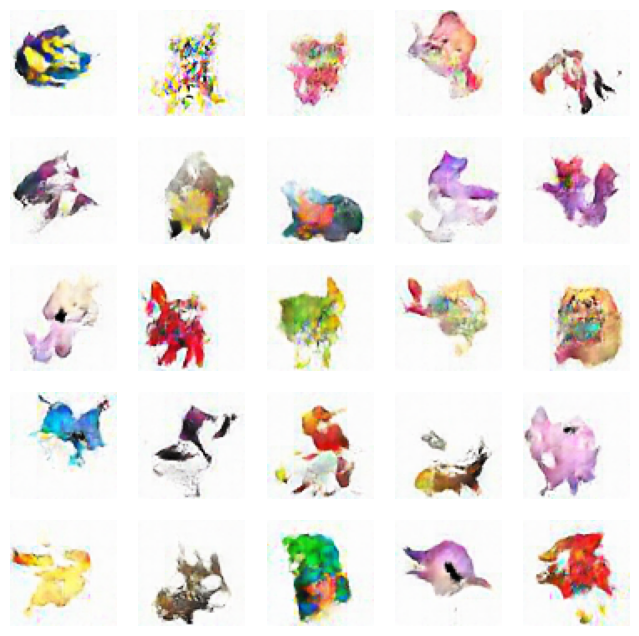

134/134 [==============================] - 10s 72ms/step - d_loss: 0.3390 - g_loss: 2.2540
Epoch 8/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3085 - g_loss: 2.2748

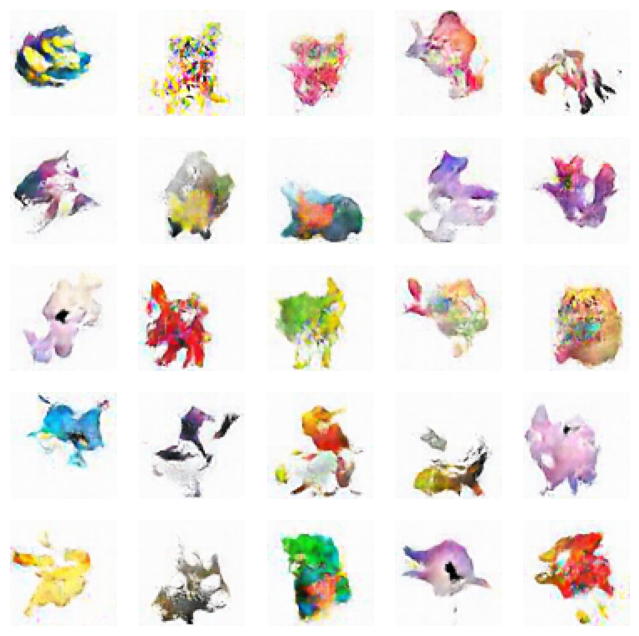

134/134 [==============================] - 10s 73ms/step - d_loss: 0.3085 - g_loss: 2.2748
Epoch 9/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3045 - g_loss: 2.3207

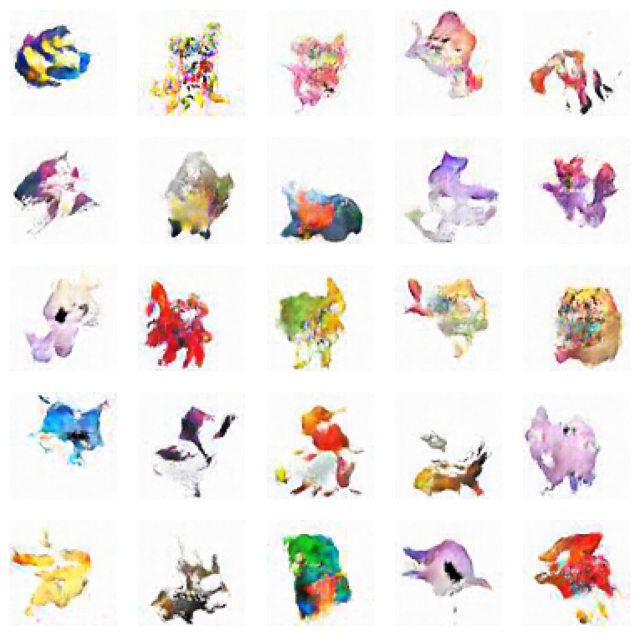

134/134 [==============================] - 10s 77ms/step - d_loss: 0.3045 - g_loss: 2.3207
Epoch 10/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3178 - g_loss: 2.3533

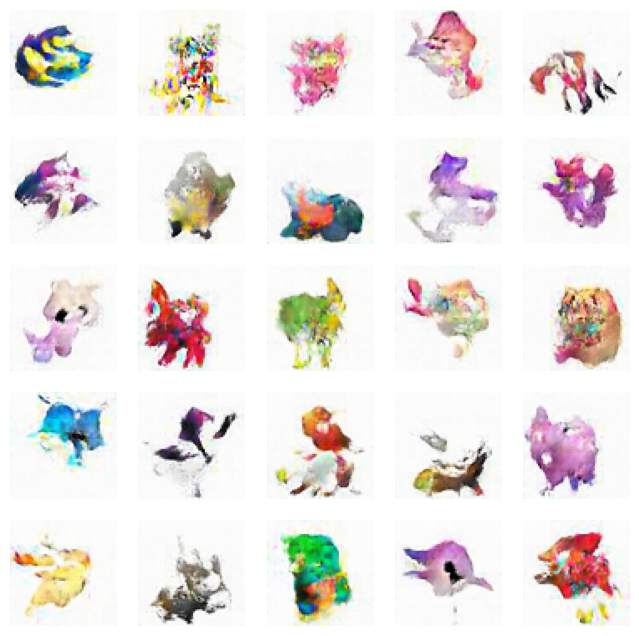

134/134 [==============================] - 10s 76ms/step - d_loss: 0.3178 - g_loss: 2.3533
Epoch 11/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2967 - g_loss: 2.3196

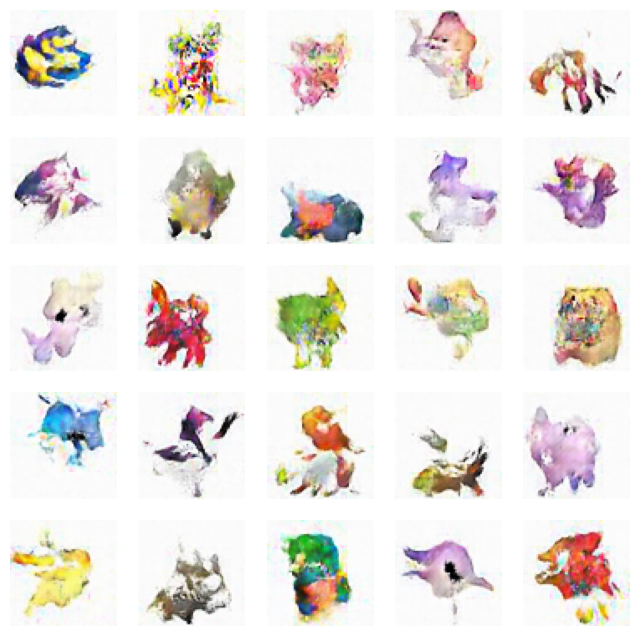

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2967 - g_loss: 2.3196
Epoch 12/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2970 - g_loss: 2.3766

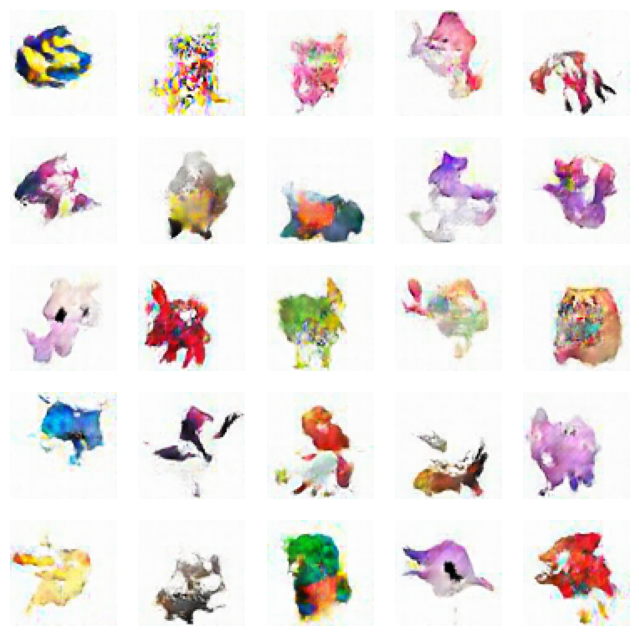

134/134 [==============================] - 10s 77ms/step - d_loss: 0.2970 - g_loss: 2.3766
Epoch 13/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3246 - g_loss: 2.3188

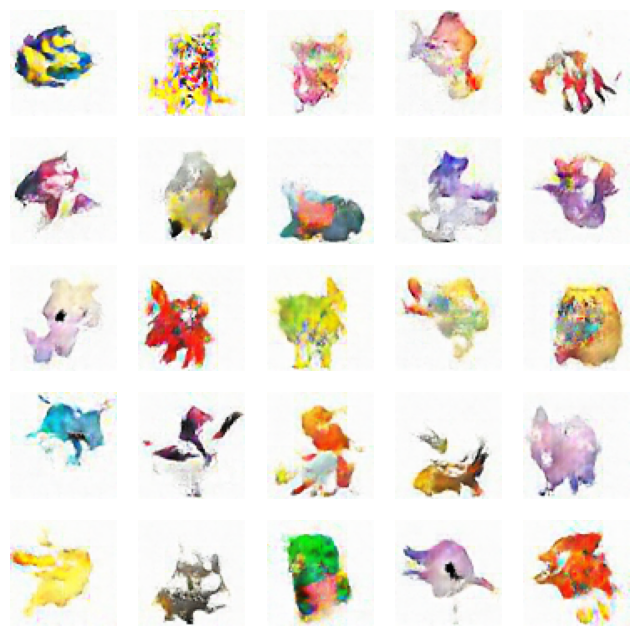

134/134 [==============================] - 10s 74ms/step - d_loss: 0.3246 - g_loss: 2.3188
Epoch 14/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3064 - g_loss: 2.3905

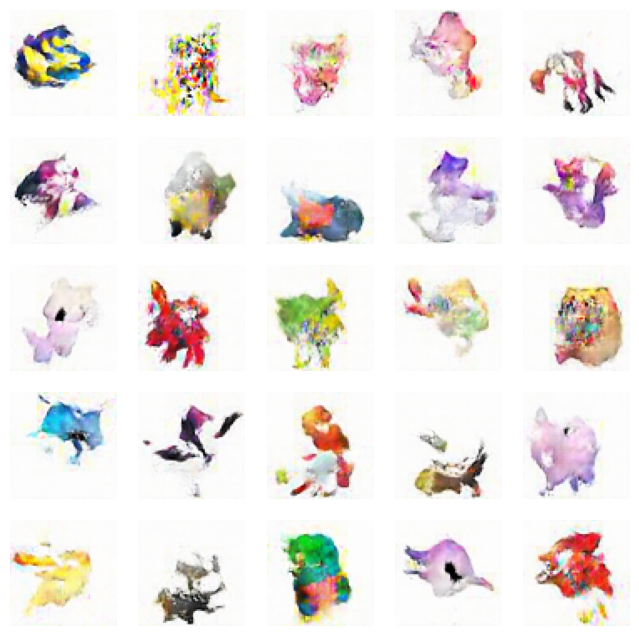

134/134 [==============================] - 10s 73ms/step - d_loss: 0.3064 - g_loss: 2.3905
Epoch 15/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3011 - g_loss: 2.3701

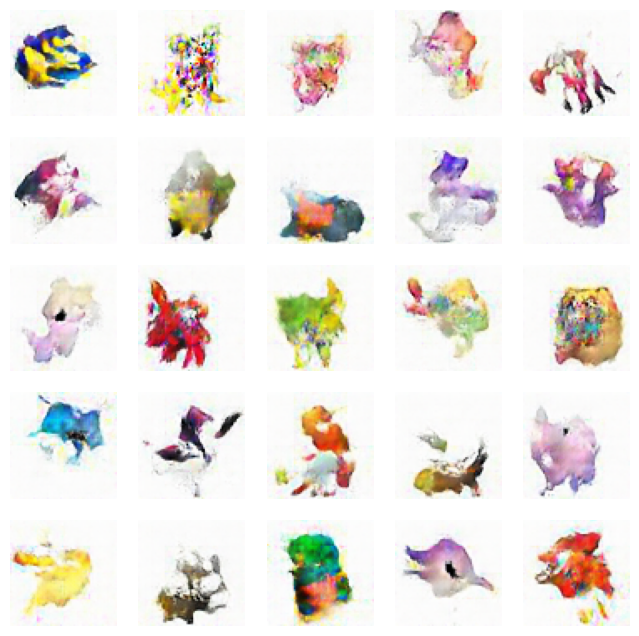

134/134 [==============================] - 12s 89ms/step - d_loss: 0.3011 - g_loss: 2.3701
Epoch 16/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3057 - g_loss: 2.4152

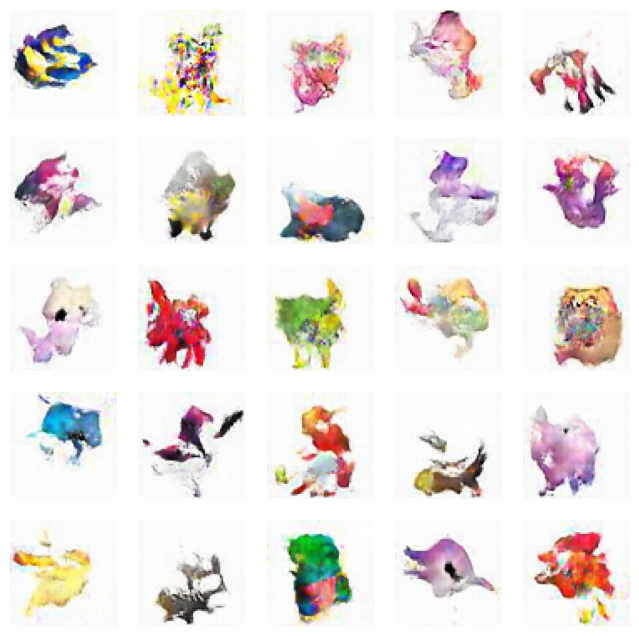

134/134 [==============================] - 10s 75ms/step - d_loss: 0.3057 - g_loss: 2.4152
Epoch 17/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3011 - g_loss: 2.4171

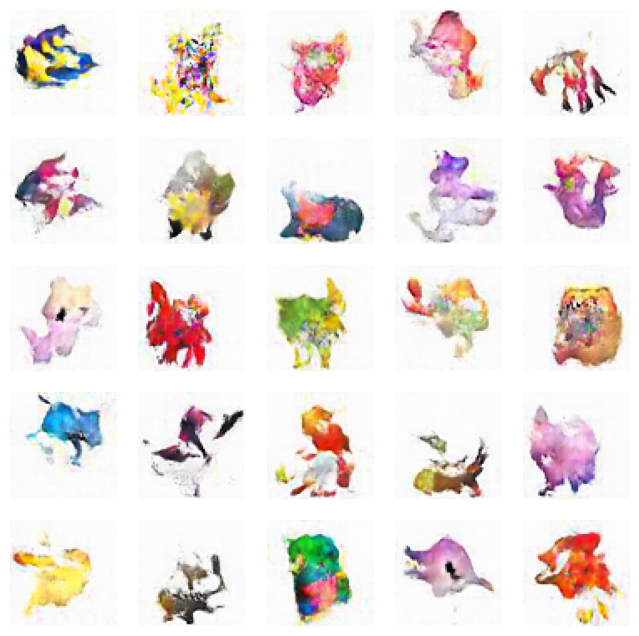

134/134 [==============================] - 10s 74ms/step - d_loss: 0.3011 - g_loss: 2.4171
Epoch 18/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3032 - g_loss: 2.4187

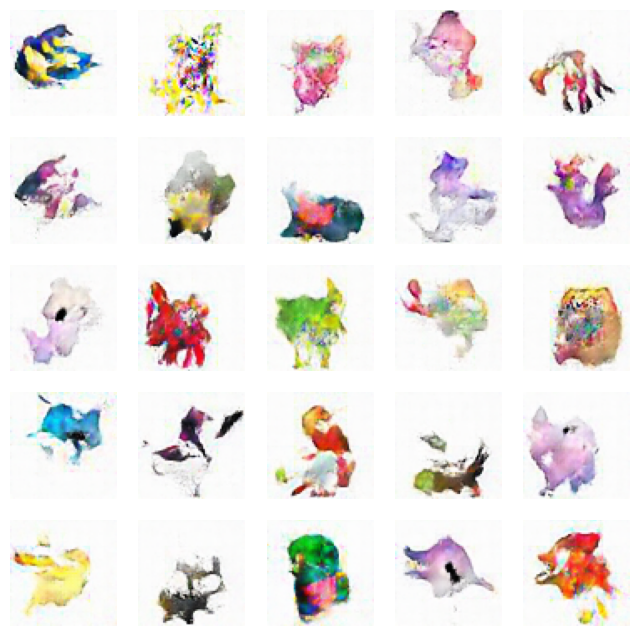

134/134 [==============================] - 10s 77ms/step - d_loss: 0.3032 - g_loss: 2.4187
Epoch 19/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2926 - g_loss: 2.3826

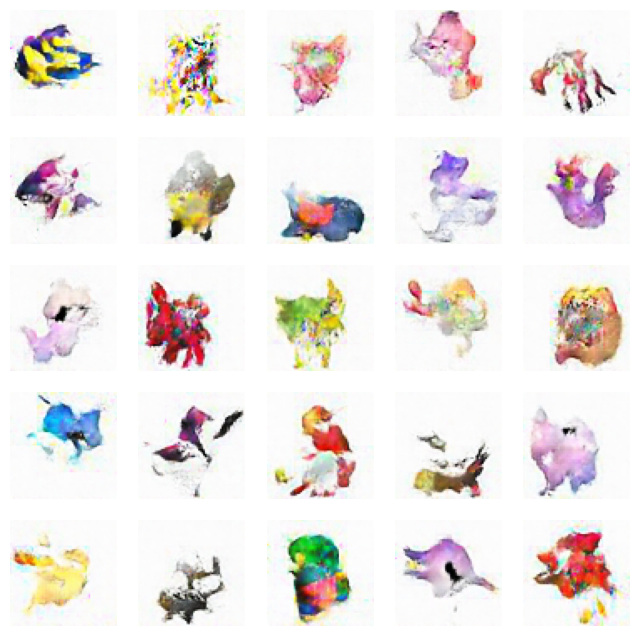

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2926 - g_loss: 2.3826
Epoch 20/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2954 - g_loss: 2.4229

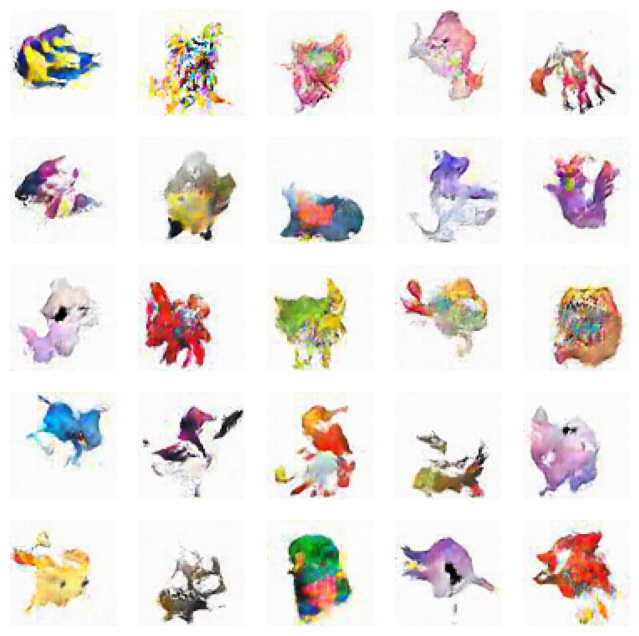

134/134 [==============================] - 10s 78ms/step - d_loss: 0.2954 - g_loss: 2.4229
Epoch 21/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2774 - g_loss: 2.4649

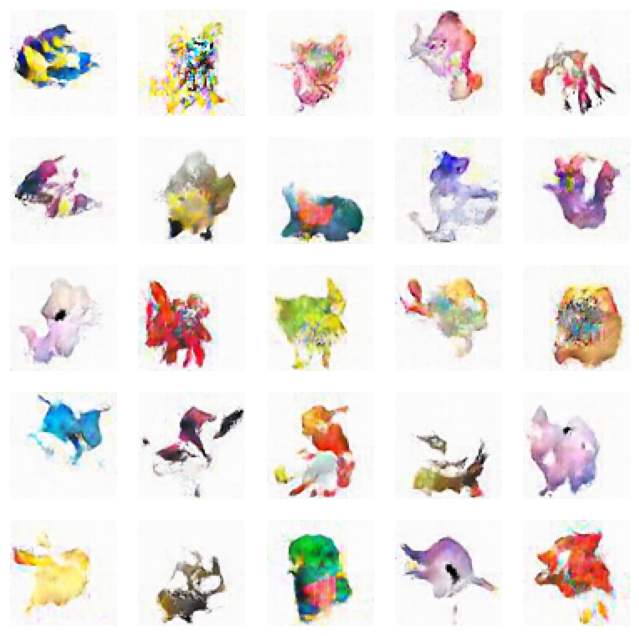

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2774 - g_loss: 2.4649
Epoch 22/50
134/134 [==============================] - ETA: 0s - d_loss: 0.3143 - g_loss: 2.4141

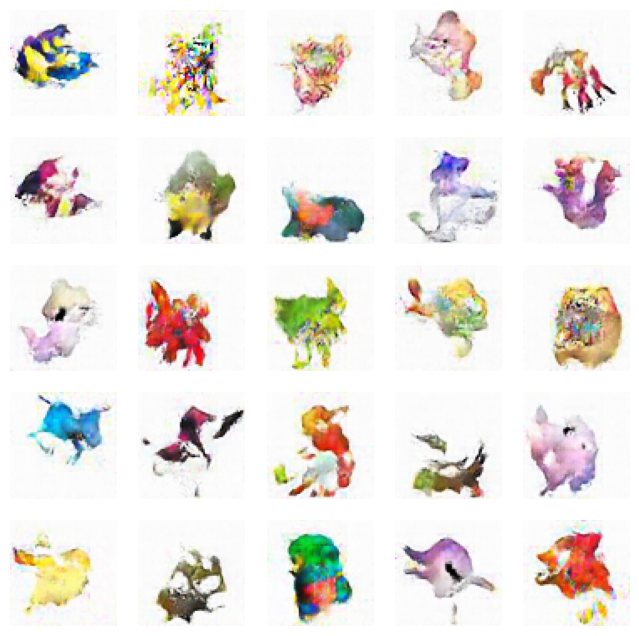

134/134 [==============================] - 10s 73ms/step - d_loss: 0.3143 - g_loss: 2.4141
Epoch 23/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2797 - g_loss: 2.4529

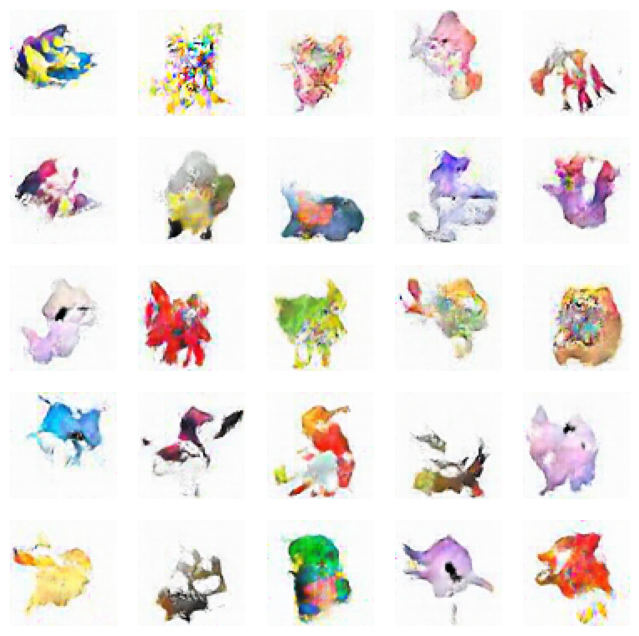

134/134 [==============================] - 10s 79ms/step - d_loss: 0.2797 - g_loss: 2.4529
Epoch 24/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2852 - g_loss: 2.4641

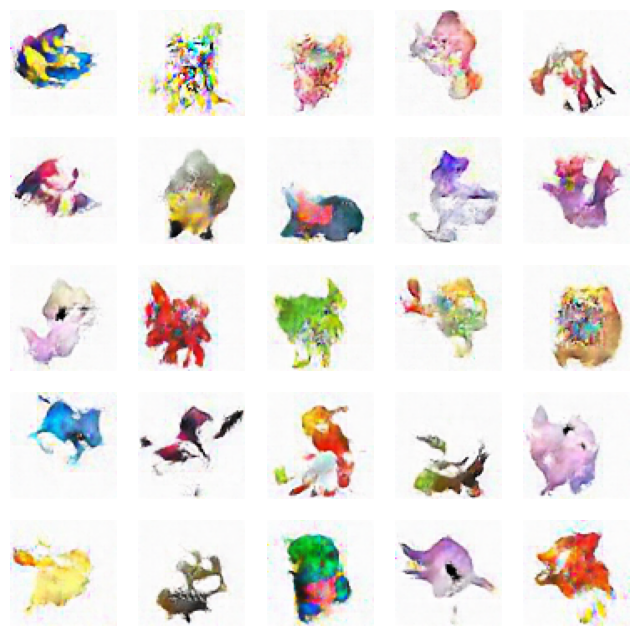

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2852 - g_loss: 2.4641
Epoch 25/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2979 - g_loss: 2.4946

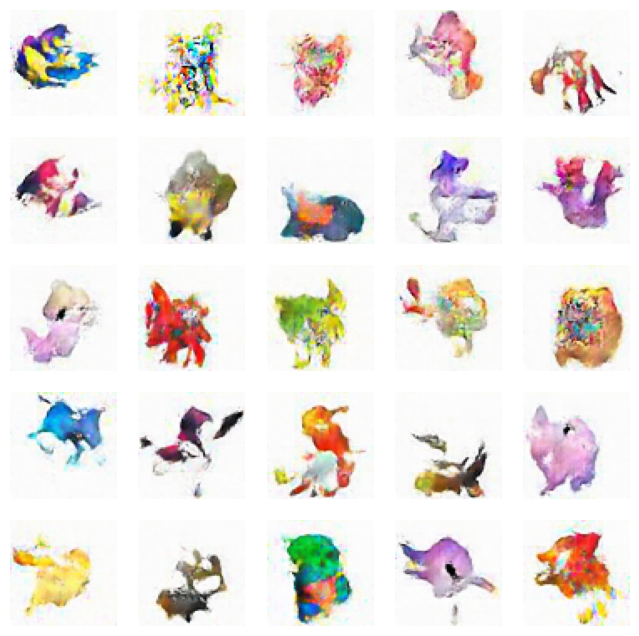

134/134 [==============================] - 10s 76ms/step - d_loss: 0.2979 - g_loss: 2.4946
Epoch 26/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2894 - g_loss: 2.5358

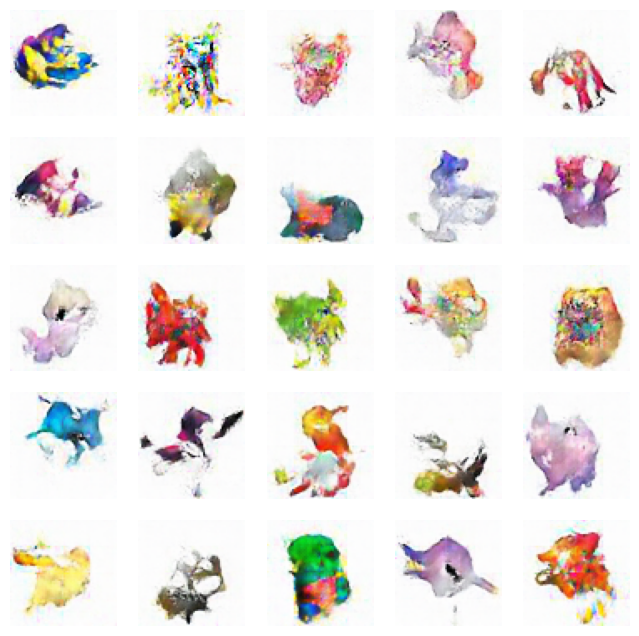

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2894 - g_loss: 2.5358
Epoch 27/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2836 - g_loss: 2.5249

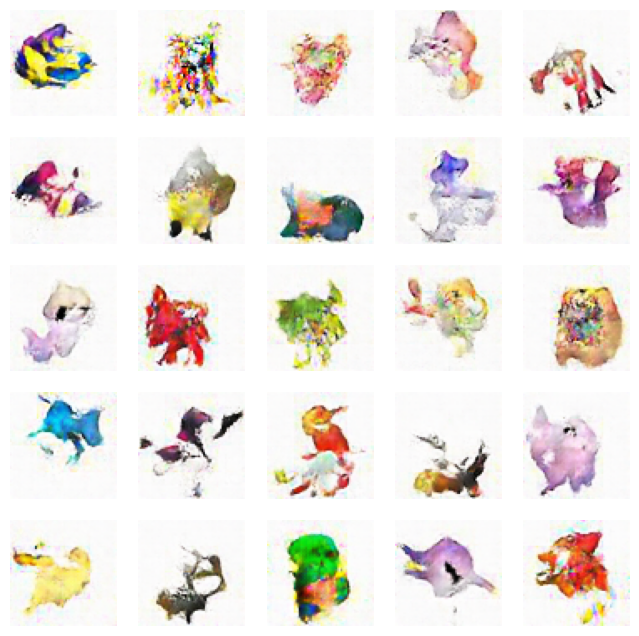

134/134 [==============================] - 10s 76ms/step - d_loss: 0.2836 - g_loss: 2.5249
Epoch 29/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2884 - g_loss: 2.6015

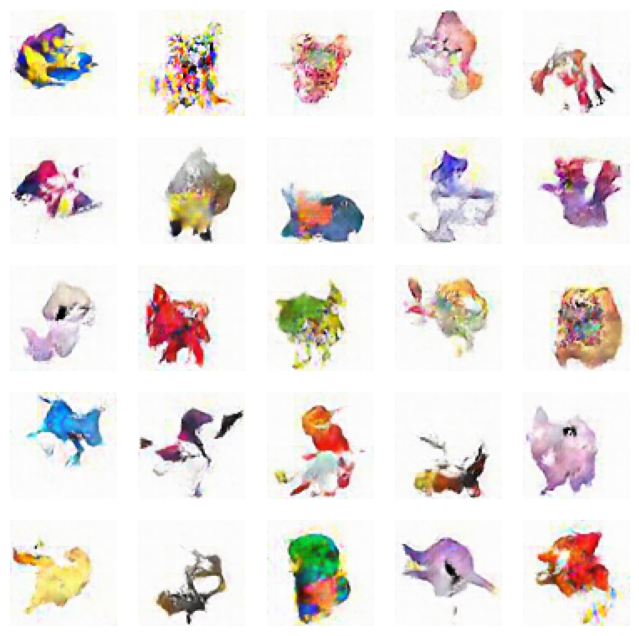

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2884 - g_loss: 2.6015
Epoch 30/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2845 - g_loss: 2.5321

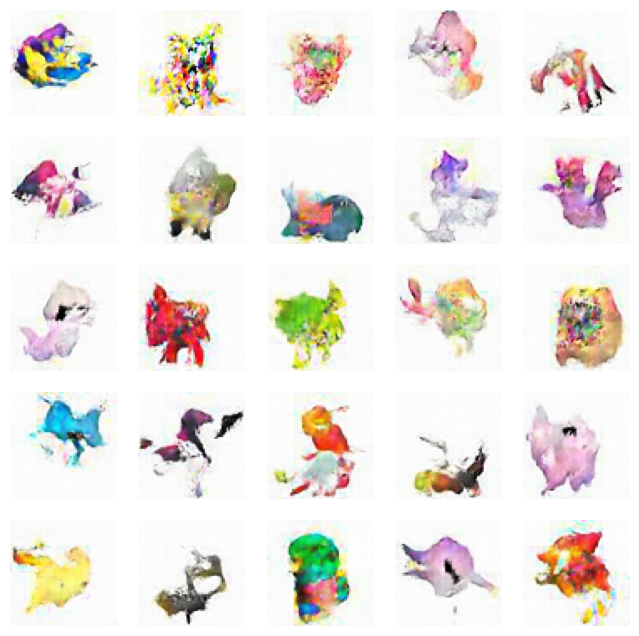

134/134 [==============================] - 10s 75ms/step - d_loss: 0.2845 - g_loss: 2.5321
Epoch 31/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2814 - g_loss: 2.5431

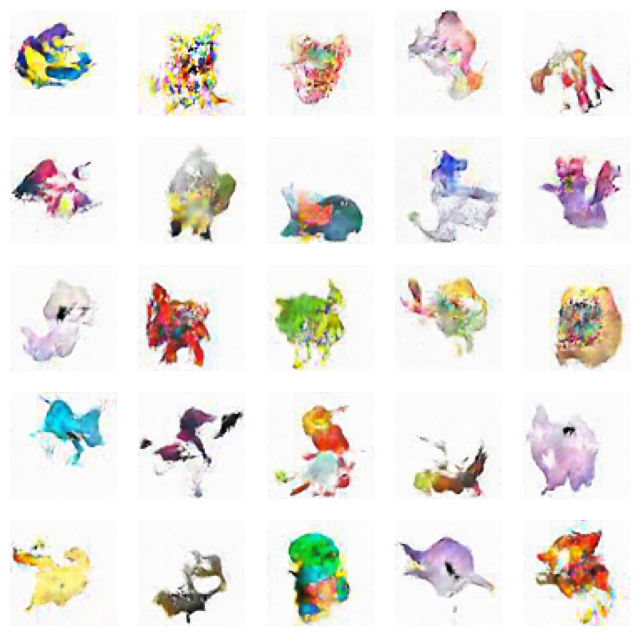

134/134 [==============================] - 10s 77ms/step - d_loss: 0.2814 - g_loss: 2.5431
Epoch 32/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2920 - g_loss: 2.5546

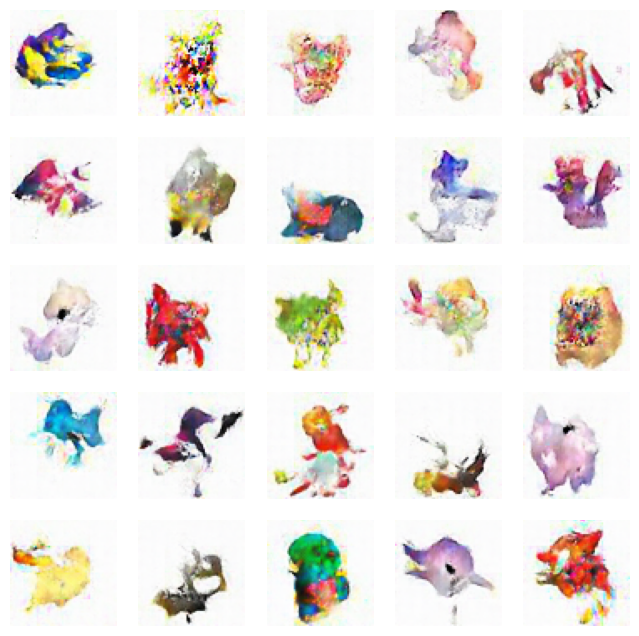

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2920 - g_loss: 2.5546
Epoch 33/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2725 - g_loss: 2.5065

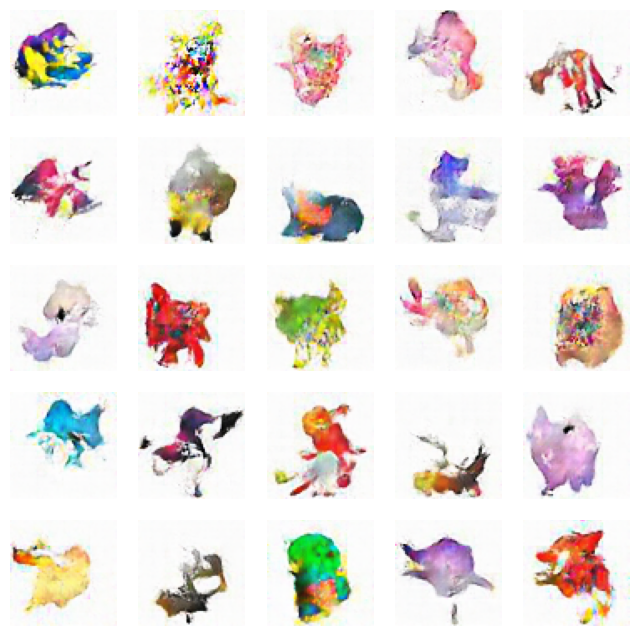

134/134 [==============================] - 10s 76ms/step - d_loss: 0.2725 - g_loss: 2.5065
Epoch 34/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2766 - g_loss: 2.5933

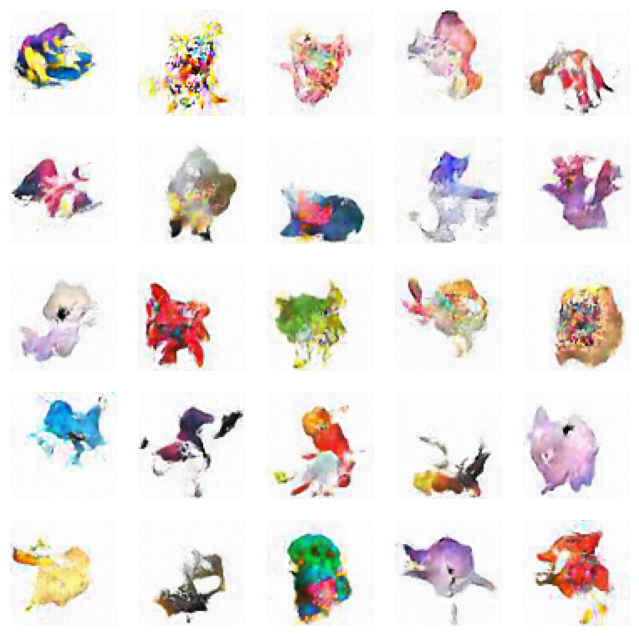

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2766 - g_loss: 2.5933
Epoch 35/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2819 - g_loss: 2.5132

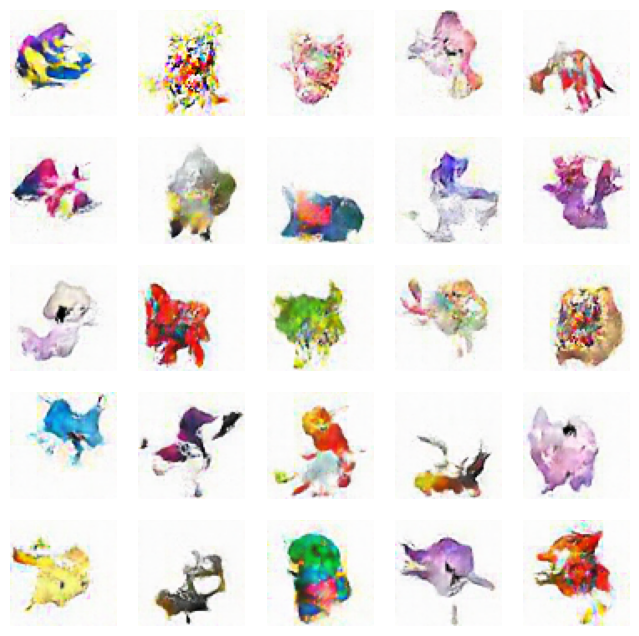

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2819 - g_loss: 2.5132
Epoch 36/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2786 - g_loss: 2.5877

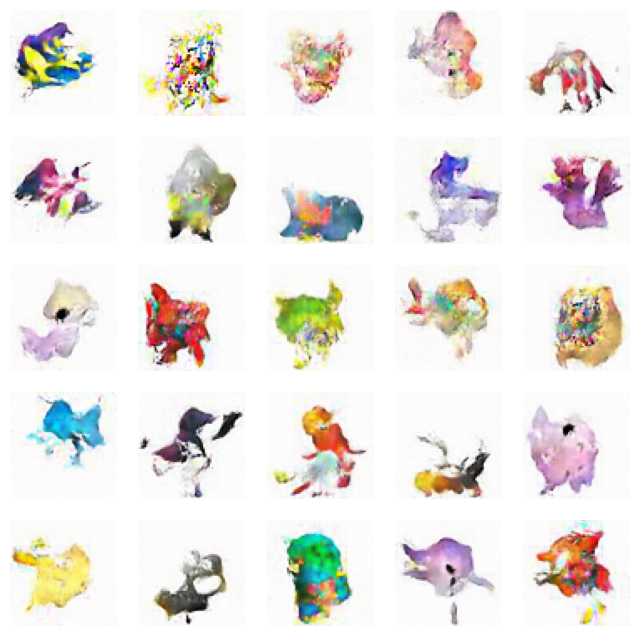

134/134 [==============================] - 10s 77ms/step - d_loss: 0.2786 - g_loss: 2.5877
Epoch 37/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2720 - g_loss: 2.5929

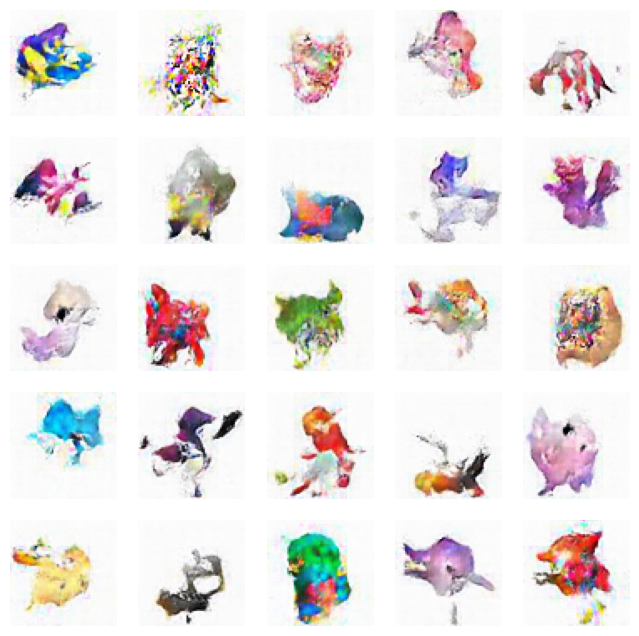

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2720 - g_loss: 2.5929
Epoch 38/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2751 - g_loss: 2.6564

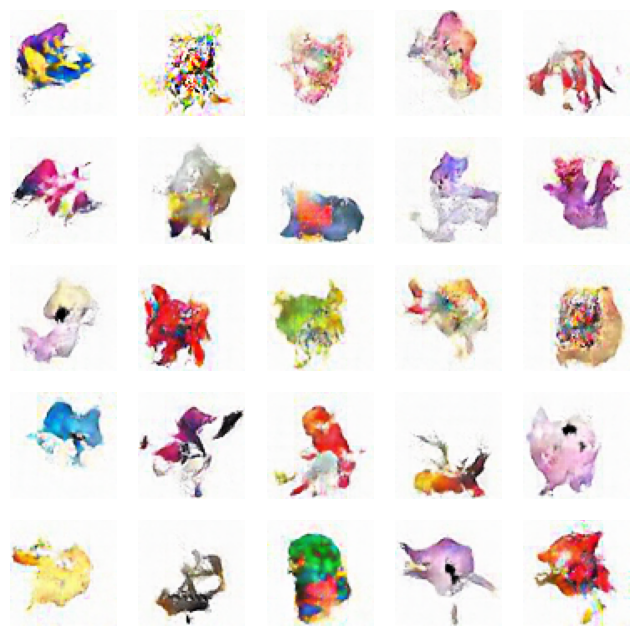

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2751 - g_loss: 2.6564
Epoch 39/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2735 - g_loss: 2.5928

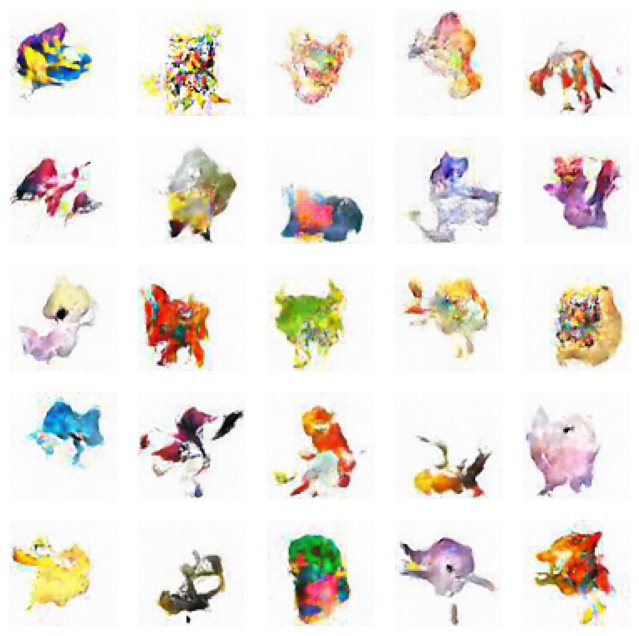

134/134 [==============================] - 10s 76ms/step - d_loss: 0.2735 - g_loss: 2.5928
Epoch 40/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2696 - g_loss: 2.5838

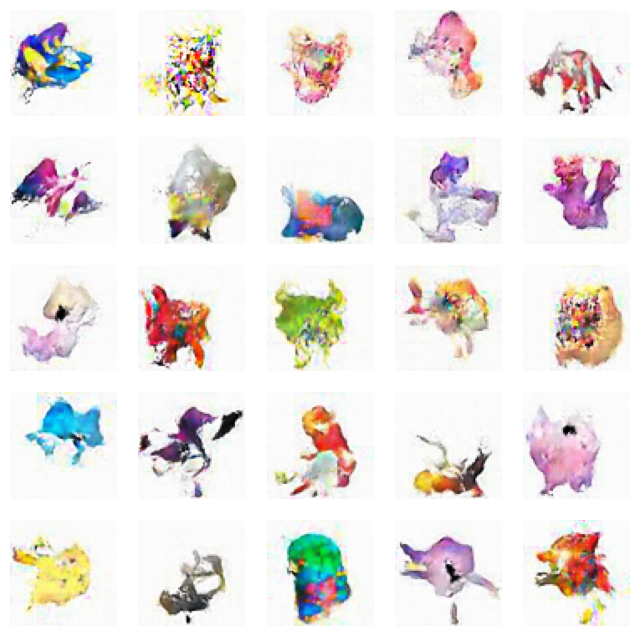

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2696 - g_loss: 2.5838
Epoch 41/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2694 - g_loss: 2.6303

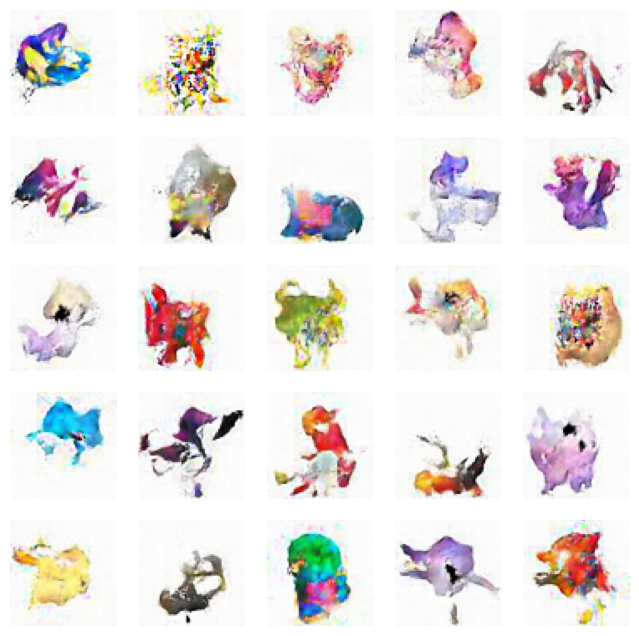

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2694 - g_loss: 2.6303
Epoch 42/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2629 - g_loss: 2.6666

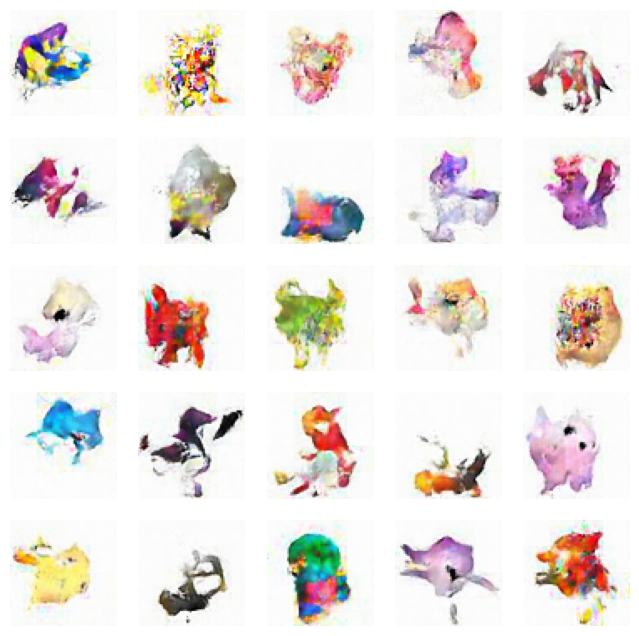

134/134 [==============================] - 10s 76ms/step - d_loss: 0.2629 - g_loss: 2.6666
Epoch 43/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2633 - g_loss: 2.6551

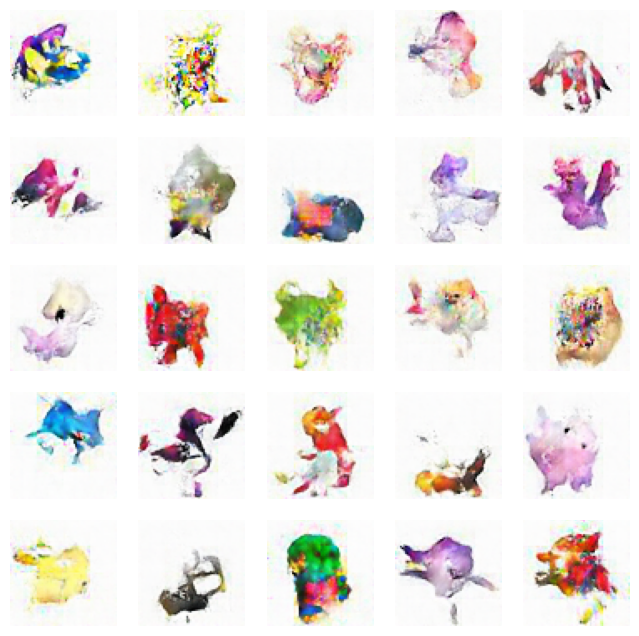

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2633 - g_loss: 2.6551
Epoch 44/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2697 - g_loss: 2.6423

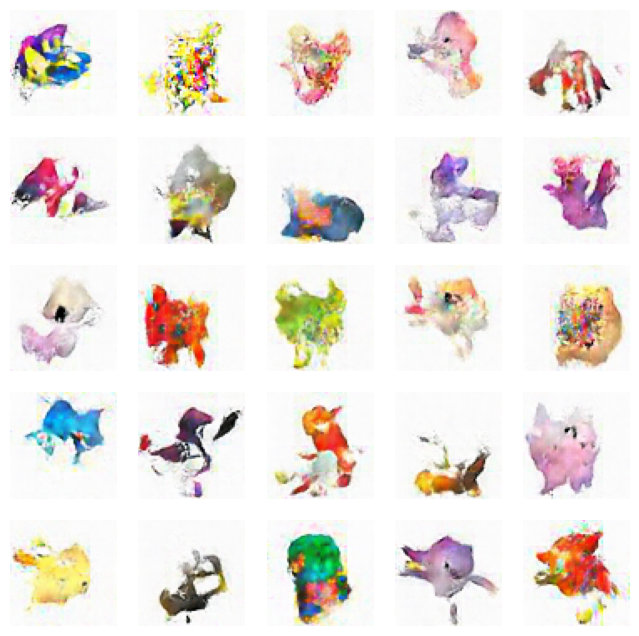

134/134 [==============================] - 10s 77ms/step - d_loss: 0.2697 - g_loss: 2.6423
Epoch 45/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2545 - g_loss: 2.6597

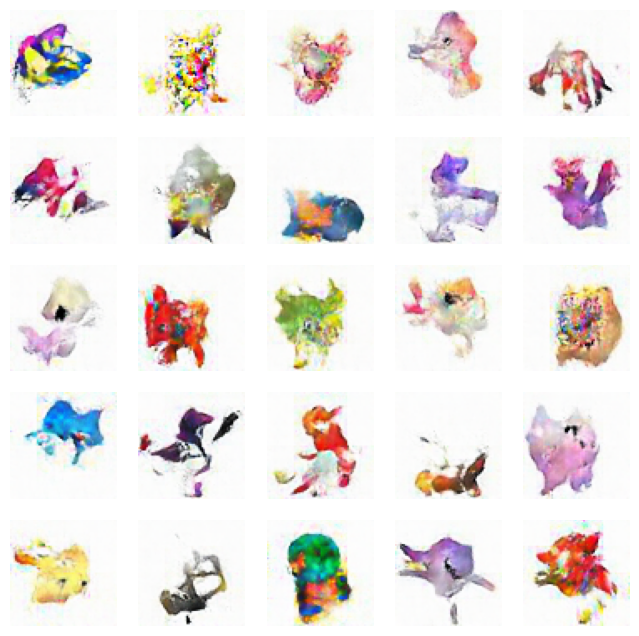

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2545 - g_loss: 2.6597
Epoch 46/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2602 - g_loss: 2.6932

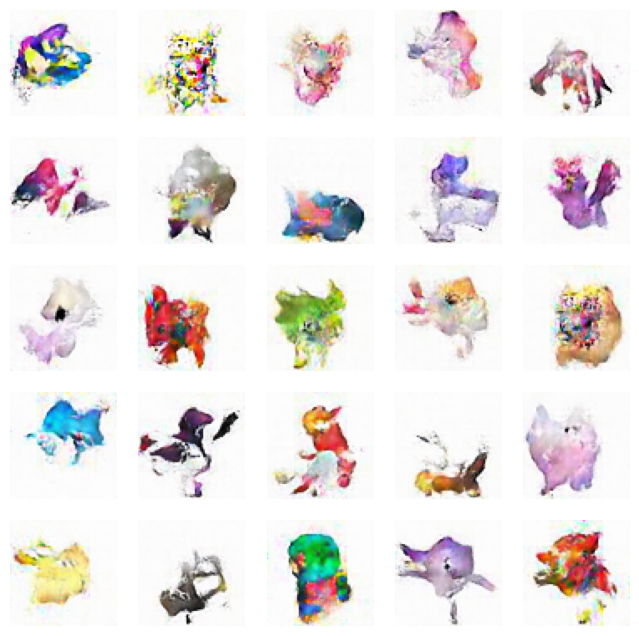

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2602 - g_loss: 2.6932
Epoch 47/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2475 - g_loss: 2.7358

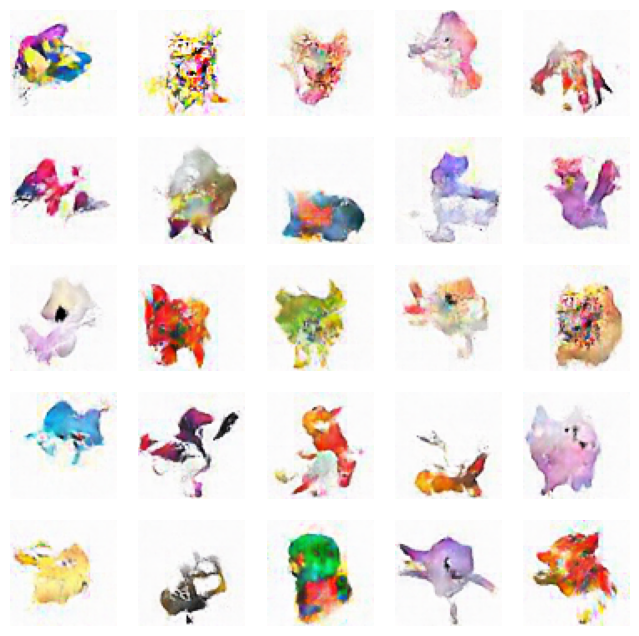

134/134 [==============================] - 10s 76ms/step - d_loss: 0.2475 - g_loss: 2.7358
Epoch 48/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2614 - g_loss: 2.7129

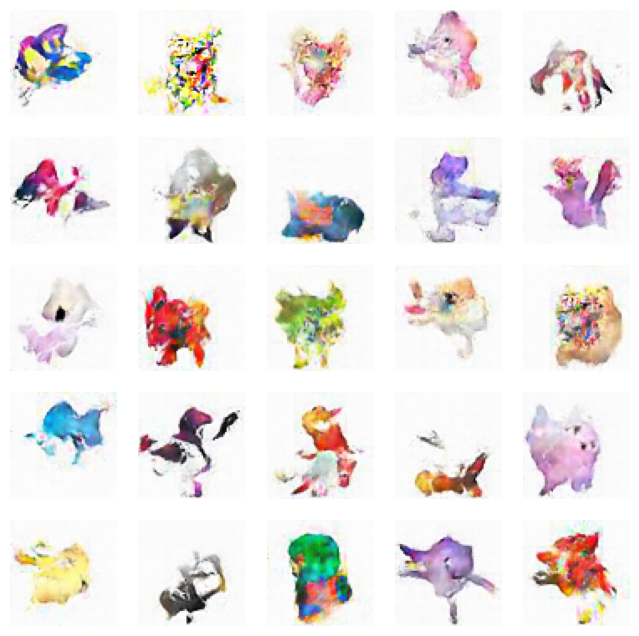

134/134 [==============================] - 10s 74ms/step - d_loss: 0.2614 - g_loss: 2.7129
Epoch 49/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2668 - g_loss: 2.7292

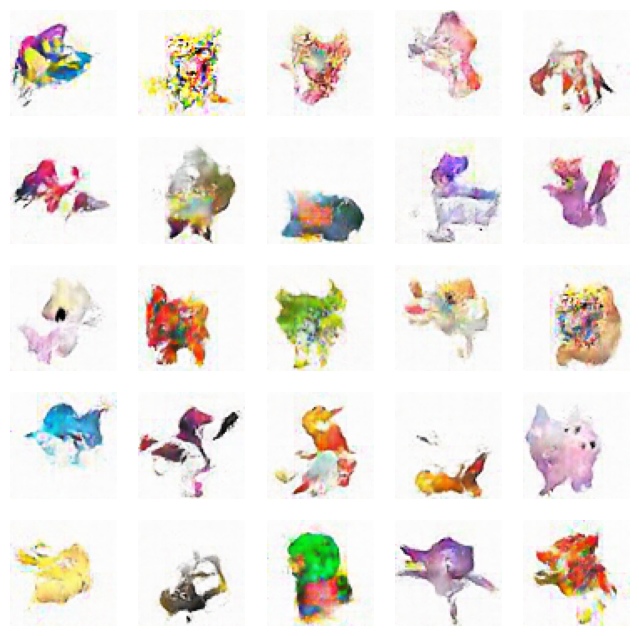

134/134 [==============================] - 10s 77ms/step - d_loss: 0.2668 - g_loss: 2.7292
Epoch 50/50
134/134 [==============================] - ETA: 0s - d_loss: 0.2527 - g_loss: 2.7084

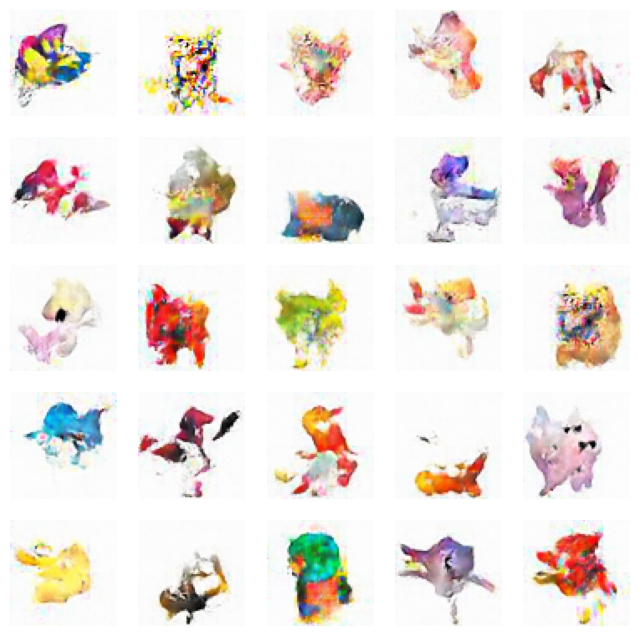

134/134 [==============================] - 10s 73ms/step - d_loss: 0.2527 - g_loss: 2.7084


In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

In [ ]:
# SAVE TRAINING AFTER COMPLETED (IF GOING TO TRAIN AGAIN LATER)
generator.save('/content/generator_model.h5')

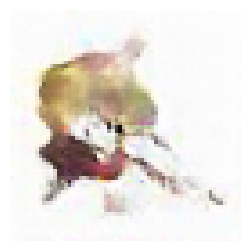

In [ ]:
# Generate New Image

noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = tf.keras.utils.array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

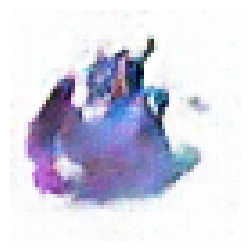

In [ ]:
# Generate New Image

noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = tf.keras.utils.array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()